In [2]:
''' 
Descargamos el data set donde estarán las imágenes de las flores. Para ello he tenido
que instalar por consola el módulo wget. Al igual que tensorflow_datasets, sirve
para descargar datasets pero es menos especifico para el entrenamiento de ia.
'''

import wget 

wget.download('https://mymldatasets.s3.eu-de.cloud-object-storage.appdomain.cloud/flowers.zip')

'flowers (1).zip'

In [3]:
''' 
Extraemos el dataset del archivo .zip en el que viene.
'''
import zipfile

with zipfile.ZipFile('flowers.zip', 'r') as zip_ref:
    zip_ref.extractall('.')

In [4]:
''' 
podemos ver que tenemos 5 clases de flores diferentes, distribuidas en 5 carpetas diferentes. 
Cada carpeta contiene varios ejemplos de flores de la categoría en cuestión.
'''
import os 

PATH = 'flowers'

classes = os.listdir(PATH)
classes

['daisy', 'dandelion', 'rose', 'sunflower', 'tulip']

In [5]:
''' 
Vemos los archivos que hay en cada carpeta.
'''
imgs, labels = [], []

for i, lab in enumerate(classes):
  paths = os.listdir(f'{PATH}/{lab}')
  print(f'Categoría: {lab}. Imágenes: {len(paths)}')
  paths = [p for p in paths if p[-3:] == "jpg"]
  imgs += [f'{PATH}/{lab}/{img}' for img in paths]
  labels += [i]*len(paths)

Categoría: daisy. Imágenes: 769
Categoría: dandelion. Imágenes: 1055
Categoría: rose. Imágenes: 784
Categoría: sunflower. Imágenes: 734
Categoría: tulip. Imágenes: 984


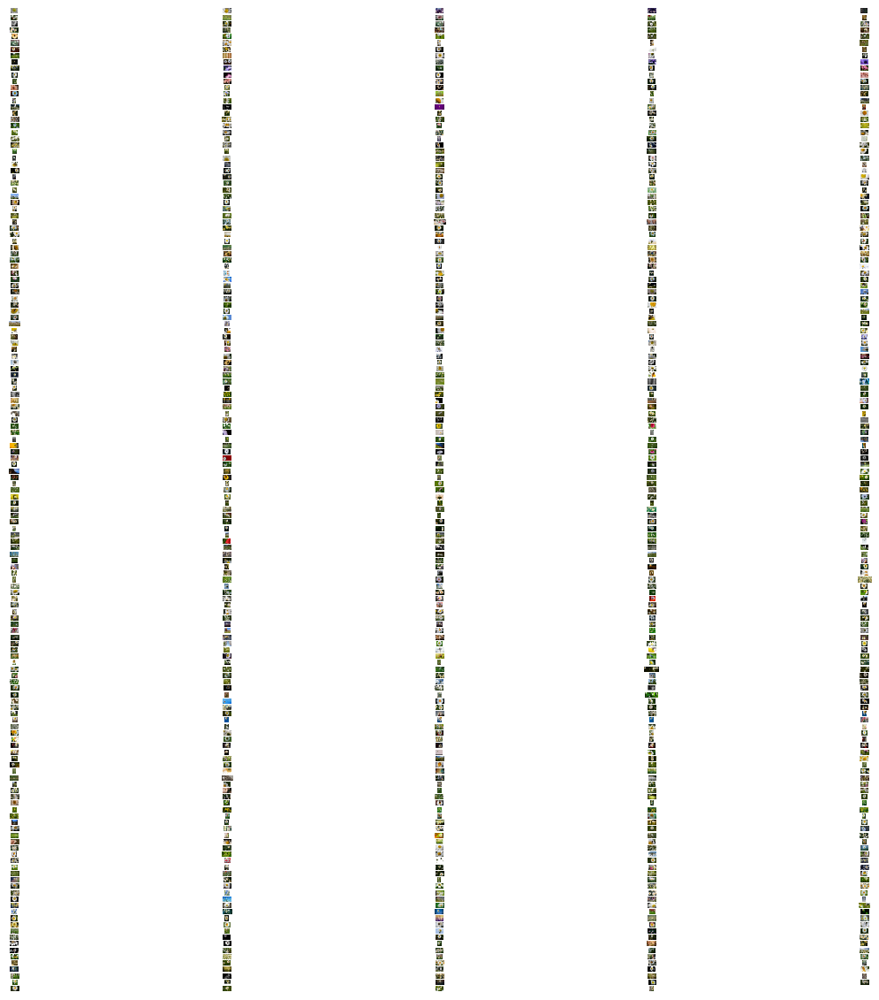

In [6]:
''' 
Opción 1 . Ver imágenes de una carpeta del dataset
'''
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Ruta a la carpeta que contiene las imágenes
image_folder = 'flowers/daisy'

# Listar todos los archivos en la carpeta
images = [f for f in os.listdir(image_folder) if f.endswith('.jpg')]

# Número de imágenes a mostrar
num_images = len(images)

# Configurar la figura
plt.figure(figsize=(15, 15))  # Ajusta el tamaño de la ventana

# Mostrar cada imagen
for i, img_name in enumerate(images):
    img_path = os.path.join(image_folder, img_name)
    img = mpimg.imread(img_path)

    plt.subplot(160, 5, i+1)  # Puedes ajustar los números (5, 5) según el número de imágenes
    plt.imshow(img)
    plt.axis('off')  # Desactivar los ejes

plt.show()

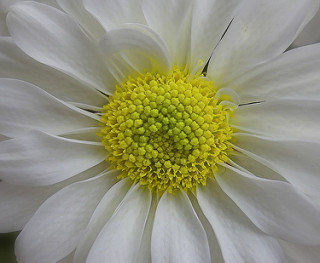

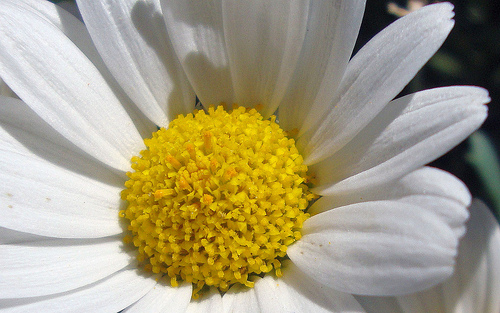

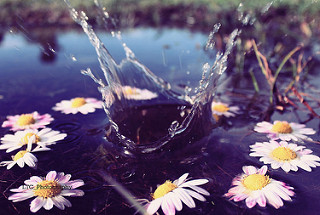

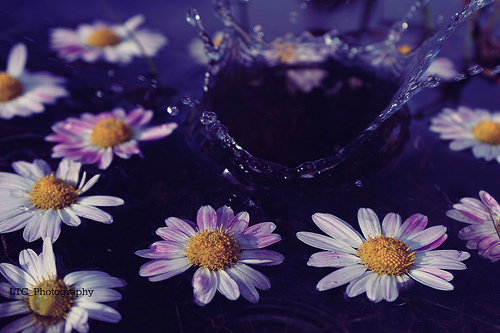

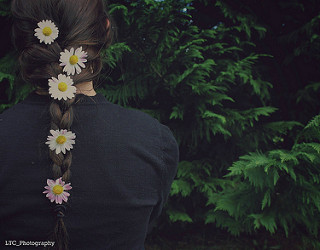

...

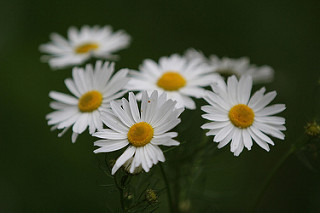

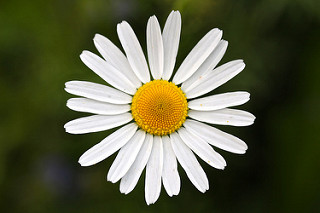

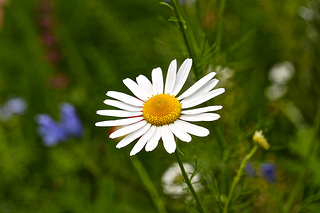

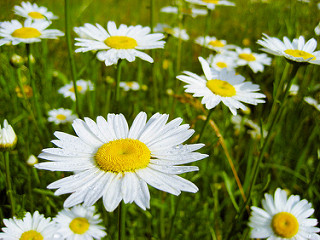

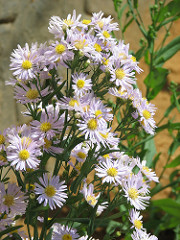

In [18]:
''' 
Opción 2. Ver imágenes de una carpeta del dataset <-- ESTA SE VE MEJOR
'''
from IPython.display import Image, display
import os

# Ruta a la carpeta que contiene las imágenes
image_folder = 'flowers/daisy'

# Listar todos los archivos en la carpeta
images = [f for f in os.listdir(image_folder) if f.endswith('.jpg')]

# Mostrar cada imagen
for img_name in images:
    img_path = os.path.join(image_folder, img_name)
    display(Image(filename=img_path))


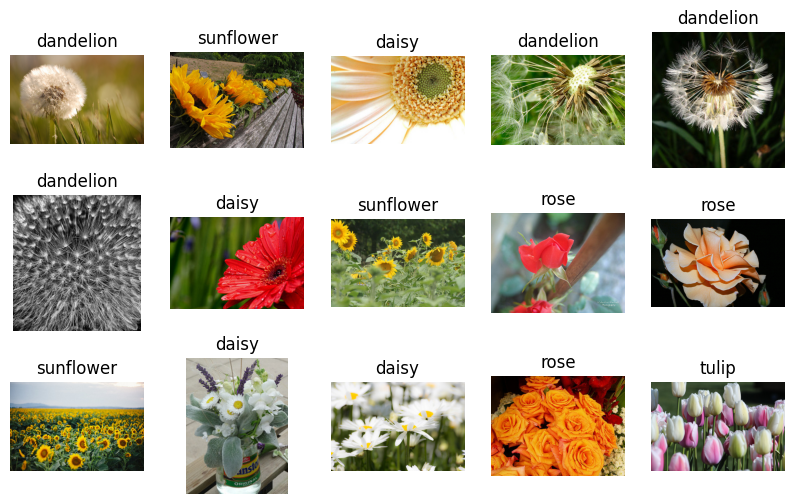

In [8]:
''' 
Opción 3. Ver imágeens aleatorias del dataset junto a aetiquetas <-- ES LA QUE USA EL CHICO
DEL VIDEO QUE ESTOY SIGUIENDO.
'''
import random 
from skimage import io
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3,5, figsize=(10,6))
for _ax in axs:
  for ax in _ax:
    ix = random.randint(0, len(imgs)-1)
    img = io.imread(imgs[ix])
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(classes[labels[ix]])
plt.show()

In [9]:
''' 
Dividimos el dataset; cogemos unas imagenes para entrenar y otras para validar.
'''
from sklearn.model_selection import train_test_split

train_imgs, test_imgs, train_labels, test_labels = train_test_split(imgs, labels, test_size=0.2, stratify=labels)

len(train_imgs), len(test_imgs)

(3458, 865)

In [10]:
''' 
Creamos nuestros objetos Dataset y DataLoader para poder darle las imágenes a nuestros modelos.
Estas imágenes deben estar normalizadas entre 0 y 1. tenemos que cambiar als dimensiones
eso, lo explica el video de Sensio en el min 2:40 en adelante.
'''
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"

class Dataset(torch.utils.data.Dataset):
  def __init__(self, X, y, trans, device):
    self.X = X
    self.y = y
    self.trans = trans
    self.device = device

  def __len__(self):
    return len(self.X)

  def __getitem__(self, ix):
    # cargar la imágen
    img = io.imread(self.X[ix])
    # aplicar transformaciones
    if self.trans:
      img = self.trans(image=img)["image"]
    return torch.from_numpy(img / 255.).float().permute(2,0,1), torch.tensor(self.y[ix])

In [11]:
''' En esta parte hacemos un redimensionado de las imagenes para que estén todas al mismo tamaño.
'''
import albumentations as A

trans = A.Compose([
    A.Resize(224, 224)
])

dataset = {
    'train': Dataset(train_imgs, train_labels, trans, device), 
    'test': Dataset(test_imgs, test_labels, trans, device)
}

len(dataset['train']), len(dataset['test'])

(3458, 865)

In [12]:
dataloader = {
    'train': torch.utils.data.DataLoader(dataset['train'], batch_size=64, shuffle=True, pin_memory=True), 
    'test': torch.utils.data.DataLoader(dataset['test'], batch_size=256, shuffle=False)
}

imgs, labels = next(iter(dataloader['train']))
imgs.shape

torch.Size([64, 3, 224, 224])

# El modelo

In [13]:
'''Vamos a escoger la arquitectura resnet para hacer nuestro clasificador. 
De este modelo usarmos todas las capas excepto la última, 
la cual sustituiremos por una nueva capa lineal para llevar a cabo la clasificación en 5 clases.

Descargamos la restnet 18 porque tiene menos capas y es más fácil de entrenar.

Imprimimos toda la lista de las capas que tiene
Exolica las capas en Min.4.22

De ste modelo usaremos todas las capas menos la última capa que la vamos a sustituir
(consiste en la última linea de la salida de este codigo). nuestra ultima capa detbe tener
5 clases y no 512 como la tiene actualmente. Gracias a esto usamos un modelo que sabe "Ver"
pero modificamos la ultima parte que es la que vamos a entrenar para que diferencie entre las 5 
clases de flores
'''
import torchvision

resnet = torchvision.models.resnet18()
resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

# Segundo entrenamiento; Pretrained = true, freeze = true

In [14]:
''' 
Definimos un nuevo modelo con las modificaciones que comentamos anteriormente 
(cambiar la ultima capa). Descargamos de nuevo resnet.
La propiedad Pretrained hace que se asignen los pesos y sesgos ya entrenados. 
La propiedd Freeze da la posibilidad de congelar la red para que una vez asignados los pesos
no se entrenen más y se queden como están.
para congelar la red
'''
class Model(torch.nn.Module):
  def __init__(self, n_outputs=5, pretrained=False, freeze=False):
    super().__init__()
    # descargamos resnet
    resnet = torchvision.models.resnet18(pretrained=pretrained)
    # nos quedamos con todas las capas menos la última
    self.resnet = torch.nn.Sequential(*list(resnet.children())[:-1])
    if freeze:
      for param in self.resnet.parameters():
        param.requires_grad=False
    # añadimos una nueva capa lineal para llevar a cabo la clasificación
    #Esta capa es la única que entrenaremos si ponememos freeze = false.
    self.fc = torch.nn.Linear(512, 5)

  def forward(self, x):
    x = self.resnet(x)
    x = x.view(x.shape[0], -1)
    x = self.fc(x)
    return x

  def unfreeze(self):
    for param in self.resnet.parameters():
        param.requires_grad=True

In [15]:
''' 
Instanciamos nuestro modelo
'''
model = Model()
outputs = model(torch.randn(64, 3, 224, 224))
outputs.shape

c:\Users\dekad\Desktop\GrupoStudium\3. Segundo DAM\7. Proyecto integrado\Espacio de trabajo\venv\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\dekad\Desktop\GrupoStudium\3. Segundo DAM\7. Proyecto integrado\Espacio de trabajo\venv\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


torch.Size([64, 5])

In [16]:
''' 
Función de entrenamiento estándar
'''
from tqdm import tqdm
import numpy as np

def fit(model, dataloader, epochs=5, lr=1e-2):
    model.to(device)
    optimizer = torch.optim.SGD(model.parameters(), lr=lr)
    criterion = torch.nn.CrossEntropyLoss()
    for epoch in range(1, epochs+1):
        model.train()
        train_loss, train_acc = [], []
        bar = tqdm(dataloader['train'])
        for batch in bar:
            X, y = batch
            X, y = X.to(device), y.to(device)
            optimizer.zero_grad()
            y_hat = model(X)
            loss = criterion(y_hat, y)
            loss.backward()
            optimizer.step()
            train_loss.append(loss.item())
            acc = (y == torch.argmax(y_hat, axis=1)).sum().item() / len(y)
            train_acc.append(acc)
            bar.set_description(f"loss {np.mean(train_loss):.5f} acc {np.mean(train_acc):.5f}")
        bar = tqdm(dataloader['test'])
        val_loss, val_acc = [], []
        model.eval()
        with torch.no_grad():
            for batch in bar:
                X, y = batch
                X, y = X.to(device), y.to(device)
                y_hat = model(X)
                loss = criterion(y_hat, y)
                val_loss.append(loss.item())
                acc = (y == torch.argmax(y_hat, axis=1)).sum().item() / len(y)
                val_acc.append(acc)
                bar.set_description(f"val_loss {np.mean(val_loss):.5f} val_acc {np.mean(val_acc):.5f}")
        print(f"Epoch {epoch}/{epochs} loss {np.mean(train_loss):.5f} val_loss {np.mean(val_loss):.5f} acc {np.mean(train_acc):.5f} val_acc {np.mean(val_acc):.5f}")

# Transfer learning
Ahora vamos a entrenar el mismo caso pero, en este caso, utilizando los pesos pre-entrenados de resnet.

In [17]:
model = Model(pretrained=True, freeze=True)
fit(model, dataloader)

c:\Users\dekad\Desktop\GrupoStudium\3. Segundo DAM\7. Proyecto integrado\Espacio de trabajo\venv\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to C:\Users\dekad/.cache\torch\hub\checkpoints\resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:13<00:00, 3.51MB/s]
val_loss 1.07270 val_acc 0.54773: 100%|██████████| 4/4 [00:59<00:00, 14.82s/it]


Epoch 1/5 loss 1.03096 val_loss 1.07270 acc 0.65597 val_acc 0.54773


val_loss 1.56271 val_acc 0.43192: 100%|██████████| 4/4 [00:49<00:00, 12.34s/it]


Epoch 2/5 loss 0.66698 val_loss 1.56271 acc 0.78920 val_acc 0.43192


val_loss 0.61093 val_acc 0.79416: 100%|██████████| 4/4 [00:48<00:00, 12.23s/it]


Epoch 3/5 loss 0.55072 val_loss 0.61093 acc 0.82955 val_acc 0.79416


val_loss 0.63513 val_acc 0.76529: 100%|██████████| 4/4 [00:48<00:00, 12.20s/it]


Epoch 4/5 loss 0.47425 val_loss 0.63513 acc 0.84972 val_acc 0.76529


val_loss 0.55437 val_acc 0.77932: 100%|██████████| 4/4 [00:48<00:00, 12.08s/it]

Epoch 5/5 loss 0.44055 val_loss 0.55437 acc 0.85881 val_acc 0.77932


# Fine Tuning
Todavía podemos mejorar un poco más si, además de utilizar los pesos descargados de Imagenet en resnet, entrenamos también la red completa.

In [19]:
model = Model(pretrained=True, freeze=False)
fit(model, dataloader)

val_loss 0.64442 val_acc 0.75127: 100%|██████████| 4/4 [00:50<00:00, 12.55s/it]


Epoch 1/5 loss 0.77856 val_loss 0.64442 acc 0.75284 val_acc 0.75127


val_loss 0.45129 val_acc 0.82310: 100%|██████████| 4/4 [00:48<00:00, 12.19s/it]


Epoch 2/5 loss 0.35921 val_loss 0.45129 acc 0.89233 val_acc 0.82310


val_loss 0.37568 val_acc 0.86528: 100%|██████████| 4/4 [00:52<00:00, 13.24s/it]


Epoch 3/5 loss 0.24996 val_loss 0.37568 acc 0.92528 val_acc 0.86528


val_loss 0.45210 val_acc 0.82513: 100%|██████████| 4/4 [00:34<00:00,  8.73s/it]


Epoch 4/5 loss 0.19905 val_loss 0.45210 acc 0.93807 val_acc 0.82513


val_loss 0.33205 val_acc 0.88501: 100%|██████████| 4/4 [00:32<00:00,  8.08s/it]

Epoch 5/5 loss 0.16166 val_loss 0.33205 acc 0.95170 val_acc 0.88501


# Otra forma de mejorar el fine tuning
Es común entrenar primero el modelo sin entrenar la red pre-entrenada durante varias epochs y después seguir entrenando, pero permitiendo ahora la actualización de pesos también en la red pre-entrenada (usualmente con un learning rate más pequeño).

In [ ]:
''' 
En teste caso la IA empeora sus resultados
'''
model = Model(pretrained=True, freeze=True)
fit(model, dataloader)
model.unfreeze()
fit(model, dataloader, lr=1e-4)

val_loss 0.99399 val_acc 0.56328: 100%|██████████| 4/4 [00:33<00:00,  8.26s/it]


Epoch 1/5 loss 1.07806 val_loss 0.99399 acc 0.62756 val_acc 0.56328


val_loss 1.41457 val_acc 0.41852: 100%|██████████| 4/4 [00:32<00:00,  8.13s/it]


Epoch 2/5 loss 0.67501 val_loss 1.41457 acc 0.79034 val_acc 0.41852


val_loss 0.61711 val_acc 0.76486: 100%|██████████| 4/4 [00:31<00:00,  7.93s/it]


Epoch 3/5 loss 0.55836 val_loss 0.61711 acc 0.83040 val_acc 0.76486


val_loss 0.56232 val_acc 0.81103: 100%|██████████| 4/4 [00:31<00:00,  7.95s/it]


Epoch 4/5 loss 0.49087 val_loss 0.56232 acc 0.85313 val_acc 0.81103


val_loss 0.51976 val_acc 0.81130: 100%|██████████| 4/4 [00:32<00:00,  8.11s/it]


Epoch 5/5 loss 0.45115 val_loss 0.51976 acc 0.85852 val_acc 0.81130


val_loss 0.46957 val_acc 0.83873: 100%|██████████| 4/4 [00:33<00:00,  8.32s/it]


Epoch 1/5 loss 0.53357 val_loss 0.46957 acc 0.80966 val_acc 0.83873


val_loss 0.47177 val_acc 0.84806: 100%|██████████| 4/4 [00:32<00:00,  8.06s/it]


Epoch 2/5 loss 0.53251 val_loss 0.47177 acc 0.82301 val_acc 0.84806


val_loss 0.47310 val_acc 0.84060: 100%|██████████| 4/4 [00:31<00:00,  7.95s/it]


Epoch 3/5 loss 0.48922 val_loss 0.47310 acc 0.83466 val_acc 0.84060


val_loss 0.43647 val_acc 0.85880: 100%|██████████| 4/4 [00:33<00:00,  8.47s/it]


Epoch 4/5 loss 0.44292 val_loss 0.43647 acc 0.86193 val_acc 0.85880


val_loss 0.42409 val_acc 0.85853: 100%|██████████| 4/4 [00:32<00:00,  8.01s/it]

Epoch 5/5 loss 0.43609 val_loss 0.42409 acc 0.86051 val_acc 0.85853
